Fetch all imagenet labels to use in webscraper

In [9]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import InceptionResNetV2
model = InceptionResNetV2(weights='imagenet', input_shape=(299, 299, 3))

225214464/225209952 [==============================] - 6s 0us/step - ETA: 11s

load sample class data already scraped in scraping.ipynb

In [4]:
import json

with open("yellow lady's slipper.json") as f:
    sample_data = json.load(f)
sample_data

{'class': "yellow lady's slipper, yellow lady-slipper, Cypripedium calceolus, Cypripedium parviflorum",
 'images': [{'href': '/pin/328973947770011704/',
   'src': 'https://i.pinimg.com/236x/45/34/ce/4534ceebdc3ff1b0c612edf73702cf73--yellow-orchid-orchid-flowers.jpg',
   'alt': 'Cypripedium irapeanum'},
  {'href': '/pin/3940718414705958/',
   'src': 'https://i.pinimg.com/236x/bf/bf/b5/bfbfb5157d33d3435ef2c1e50e717178.jpg',
   'alt': ' '},
  {'href': '/pin/31877109852118418/',
   'src': 'https://i.pinimg.com/236x/22/3e/ae/223eae276157f67c68ed0a37bc93c78b.jpg',
   'alt': "Our classic Lady's Slipper Engagement Ring, featuring a 1.5ct. oval cut diamond. Set in 14k gold with diamond accents and a thin band, this signature piece is available at melaniecasey.com in yellow, white, and rose gold."},
  {'href': '/pin/235876099210034600/',
   'src': 'https://i.pinimg.com/236x/c4/e6/99/c4e6999c88dd8a91ea4bd0bce9126fa1--pretty-flowers-exotic-flowers.jpg',
   'alt': "Yellow Lady's-slipper (Cypripediu

In [6]:
img_url = sample_data["images"][0]["src"]

In [10]:
# img_url = "https://storage.googleapis.com/download.tensorflow.org/example_images/592px-Red_sunflower.jpg"
img_path = tf.keras.utils.get_file('test_img', origin=img_url)
img = tf.keras.preprocessing.image.load_img(
    img_path, target_size=(299, 299)
)
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0)

prediction = model.predict(img_array)
score = tf.nn.softmax(prediction[0])
print(prediction)
print(score)

[[0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00 0.00000e+00
  0.00000e+00 0.00000e+00 0.00000e+00 

fetch imagenet labels

In [11]:
labels_path = tf.keras.utils.get_file('ImageNetLabels.txt','https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt')
imagenet_labels = np.array(open(labels_path).read().splitlines())
imagenet_labels

16384/10484 [==============================================] - 0s 0us/step


array(['background', 'tench', 'goldfish', ..., 'bolete', 'ear',
       'toilet tissue'], dtype='<U30')

check image and predicted label

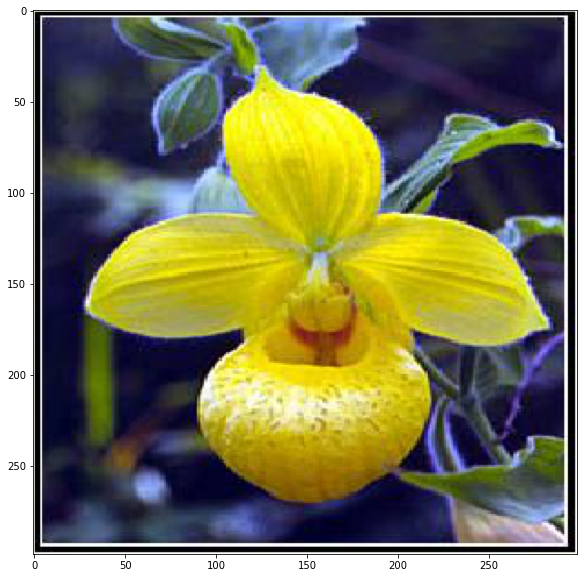

In [13]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
plt.imshow(img_array[0].numpy().astype("uint8"))

In [14]:
print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(imagenet_labels[np.argmax(score)], 100 * np.max(score))
)

This image most likely belongs to web site with a 0.27 percent confidence.


...not as good a result as expected. Let's try another


In [22]:
for img in sample_data["images"]:
    print(img["src"])

https://i.pinimg.com/236x/45/34/ce/4534ceebdc3ff1b0c612edf73702cf73--yellow-orchid-orchid-flowers.jpg
https://i.pinimg.com/236x/bf/bf/b5/bfbfb5157d33d3435ef2c1e50e717178.jpg
https://i.pinimg.com/236x/22/3e/ae/223eae276157f67c68ed0a37bc93c78b.jpg
https://i.pinimg.com/236x/c4/e6/99/c4e6999c88dd8a91ea4bd0bce9126fa1--pretty-flowers-exotic-flowers.jpg
https://i.pinimg.com/236x/bb/c7/c4/bbc7c42fbc4fe58fe0691b2e0bb75168--pretty-flowers-orchids.jpg
https://i.pinimg.com/236x/54/b6/f9/54b6f9c2824646f9e419178f20cdceb3--lady-slipper-orchid-hoa-lan.jpg
https://i.pinimg.com/236x/08/4f/85/084f85c5b7eae7686ca2fd06e287fd25--art-flowers-exotic-flowers.jpg
https://i.pinimg.com/236x/a0/f7/3e/a0f73ec41ad6df7b4e9d25c5872caa8b--lady-slipper-orchid-exotic-flowers.jpg
https://i.pinimg.com/236x/69/15/66/691566400ee1050a6758dac9424e67a2--orchid-care-unusual-plants.jpg
https://i.pinimg.com/236x/8f/37/fe/8f37fe0ad97f1a2b8c1825d347678ecd--delicate-engagement-ring-diamond-engagement-rings.jpg
https://i.pinimg.com/23

https://i.pinimg.com/236x/69/15/66/691566400ee1050a6758dac9424e67a2--orchid-care-unusual-plants.jpg
24576/21545 [==================================] - 0s 0us/step
This image most likely belongs to web site with a 0.27 percent confidence.


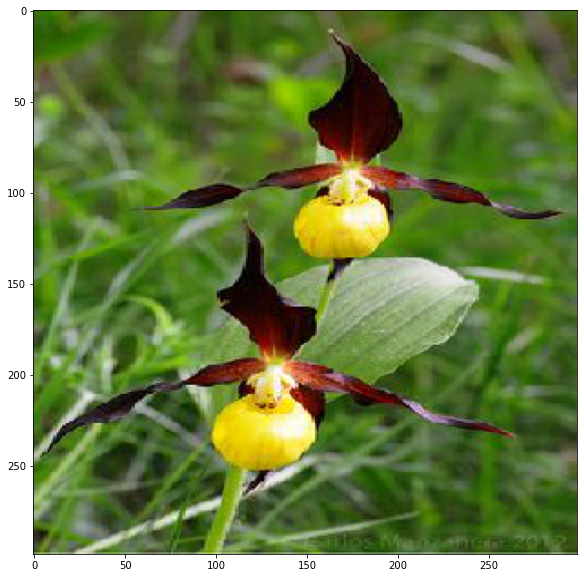

In [28]:
i = 8
img_data = sample_data["images"][i]
img_url = img_data["src"]
print(img_url)

img_path = tf.keras.utils.get_file(f"test_{i}", origin=img_url)
img = tf.keras.preprocessing.image.load_img(
    img_path, target_size=(299, 299)
)
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0)

plt.figure(figsize=(10, 10))
plt.imshow(img_array[0].numpy().astype("uint8"))

prediction = model.predict(img_array)
score = tf.nn.softmax(prediction[0])
print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(imagenet_labels[np.argmax(score)], 100 * np.max(score))
)

In [29]:
sunflower_url = "https://storage.googleapis.com/download.tensorflow.org/example_images/592px-Red_sunflower.jpg"
sunflower_path = tf.keras.utils.get_file('red_sunflower', origin=sunflower_url)

img = tf.keras.preprocessing.image.load_img(
    sunflower_path, target_size=(299, 299)
)
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0) # Create a batch

predictions = model.predict(img_array)
score = tf.nn.softmax(predictions[0])

print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(imagenet_labels[np.argmax(score)], 100 * np.max(score))
)

This image most likely belongs to web site with a 0.27 percent confidence.


consistently predicting "web site" class, must be a preprocessing issue

In [31]:
from tensorflow.keras.applications.inception_resnet_v2 import preprocess_input
img = tf.keras.preprocessing.image.load_img(
    sunflower_path, target_size=(299, 299)
)

img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0) # Create a batch
img_processed = preprocess_input(img_array)
predictions = model.predict(img_processed)
score = tf.nn.softmax(predictions[0])

print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(imagenet_labels[np.argmax(score)], 100 * np.max(score))
)

This image most likely belongs to daisy with a 0.26 percent confidence.


preprocess input seems to work, let's test on scraped images

https://i.pinimg.com/236x/08/4f/85/084f85c5b7eae7686ca2fd06e287fd25--art-flowers-exotic-flowers.jpg
16384/12751 [======================================] - 0s 0us/step
This image most likely belongs to daisy with a 0.26 percent confidence.


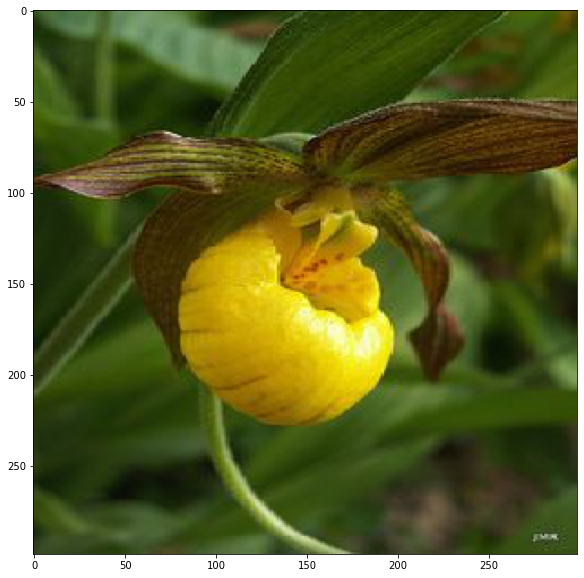

In [43]:
i = 6
img_data = sample_data["images"][i]
img_url = img_data["src"]
print(img_url)

img_path = tf.keras.utils.get_file(f"test_{i}", origin=img_url)
img = tf.keras.preprocessing.image.load_img(
    img_path, target_size=(299, 299)
)
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0)
plt.figure(figsize=(10, 10))
plt.imshow(img_array[0].numpy().astype("uint8"))

img_array = preprocess_input(img_array)



prediction = model.predict(img_array)
score = tf.nn.softmax(prediction[0])
print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(imagenet_labels[np.argmax(score)], 100 * np.max(score))
)

okay, so all we're getting is daisy... let's test the snake fence class images already scraped

In [44]:
with open("sample_urls.json") as f:
    sample_data = json.load(f)
sample_data

{'class': 'snake fence',
 'urls': ['https://i.pinimg.com/236x/59/27/d7/5927d7038bfee63556b8d08de2620958.jpg',
  'https://i.pinimg.com/236x/60/d2/44/60d24494379e6c56e8a9826e77560789--rail-fence-cabin-ideas.jpg',
  'https://i.pinimg.com/236x/a8/7e/cf/a87ecfdbe16fef29e77069b518cdd148--garden-fencing-herb-garden.jpg',
  'https://i.pinimg.com/236x/0b/ca/1b/0bca1b1c276a353a1616e6556768b14d.jpg',
  'https://i.pinimg.com/236x/82/91/9f/82919f933f72def879ac71694a88ec56.jpg',
  'https://i.pinimg.com/236x/c0/f8/a7/c0f8a782bbfb890525c907fcf000fd46.jpg',
  'https://i.pinimg.com/236x/36/54/f9/3654f968b7213f03966e5c3ff71b3baf.jpg',
  'https://i.pinimg.com/236x/ad/73/65/ad73657f98d1aa36cbb0baf9f46188f4--coastal-cottage-coastal-garden.jpg',
  'https://i.pinimg.com/236x/23/e9/a3/23e9a3eaa06803ce800afe3070251477--wood-fence-post-fence-posts.jpg',
  'https://i.pinimg.com/236x/58/a2/ce/58a2ce05d78dbc18c42870753448a50b.jpg',
  'https://i.pinimg.com/236x/db/74/7c/db747cb0f71e3df1f9fc379063ca36e0.jpg',
  'http

https://i.pinimg.com/236x/59/27/d7/5927d7038bfee63556b8d08de2620958.jpg
This image most likely belongs to Loafer with a 0.14 percent confidence.
https://i.pinimg.com/236x/60/d2/44/60d24494379e6c56e8a9826e77560789--rail-fence-cabin-ideas.jpg
This image most likely belongs to wool with a 0.25 percent confidence.
https://i.pinimg.com/236x/a8/7e/cf/a87ecfdbe16fef29e77069b518cdd148--garden-fencing-herb-garden.jpg
This image most likely belongs to four-poster with a 0.19 percent confidence.
https://i.pinimg.com/236x/0b/ca/1b/0bca1b1c276a353a1616e6556768b14d.jpg
This image most likely belongs to rock python with a 0.13 percent confidence.
https://i.pinimg.com/236x/82/91/9f/82919f933f72def879ac71694a88ec56.jpg
This image most likely belongs to bonnet with a 0.11 percent confidence.
https://i.pinimg.com/236x/c0/f8/a7/c0f8a782bbfb890525c907fcf000fd46.jpg
This image most likely belongs to passenger car with a 0.16 percent confidence.
https://i.pinimg.com/236x/36/54/f9/3654f968b7213f03966e5c3ff71b

<ipython-input-46-1bb9f5bcfad4>:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10, 10))


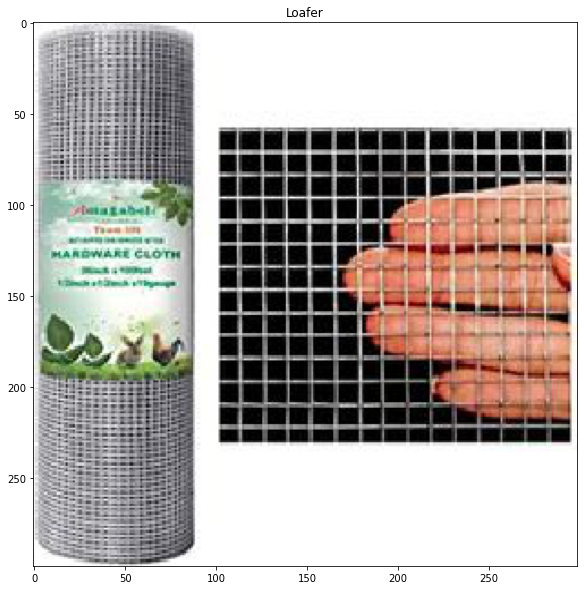

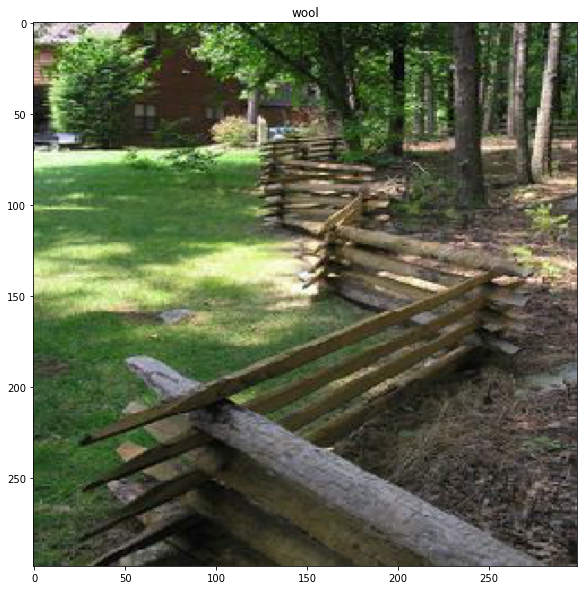

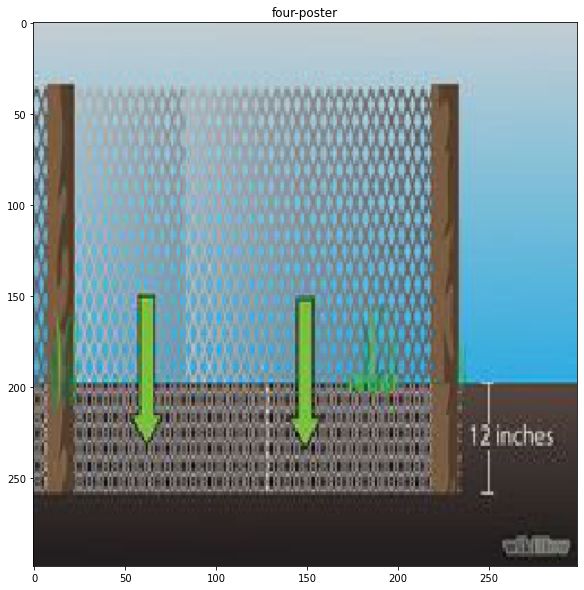

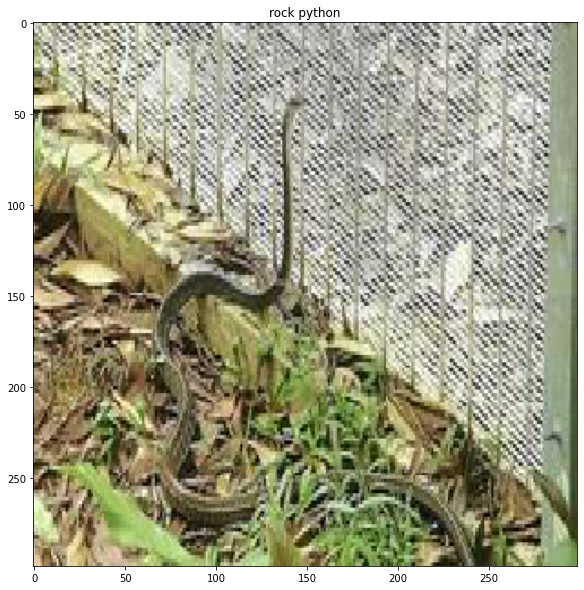

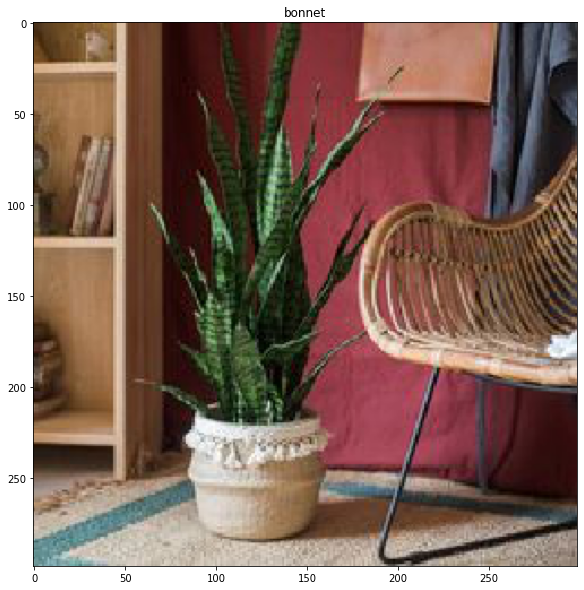

...

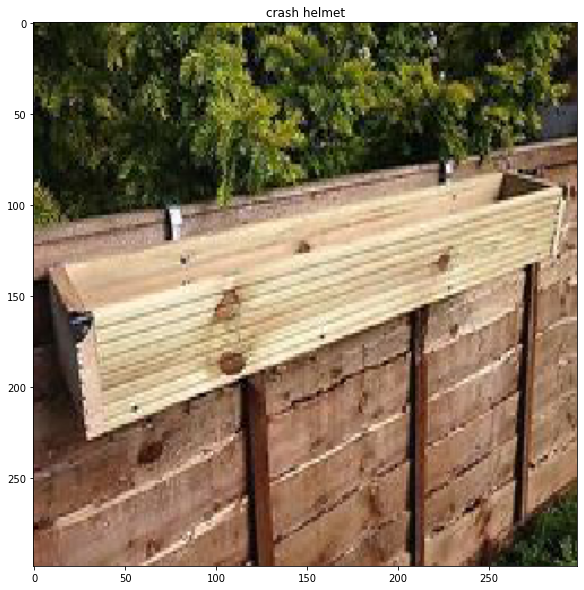

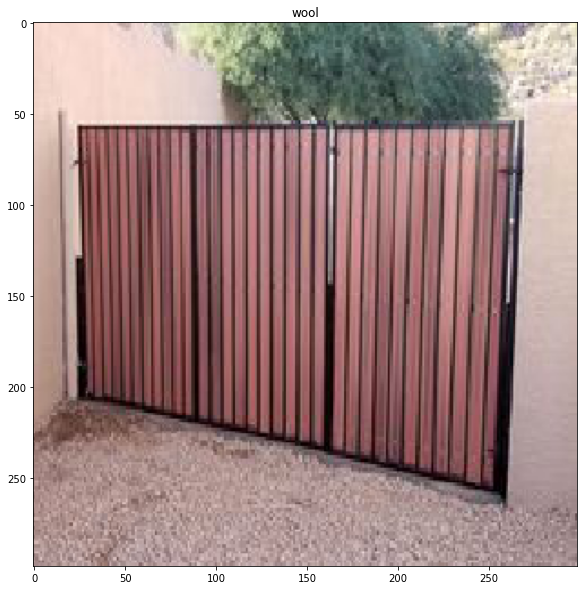

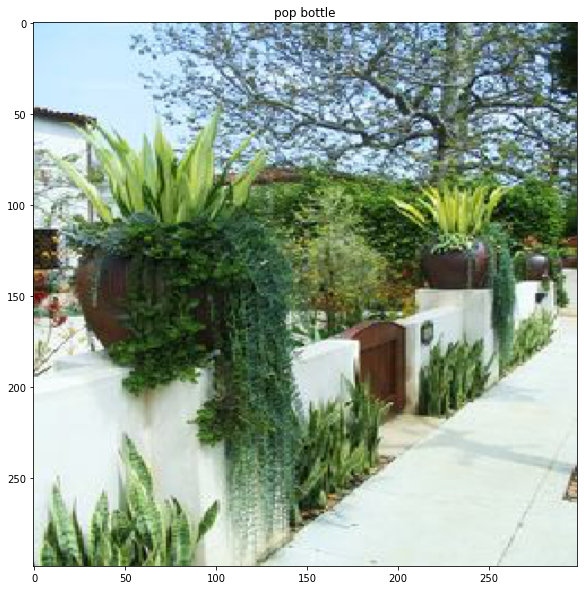

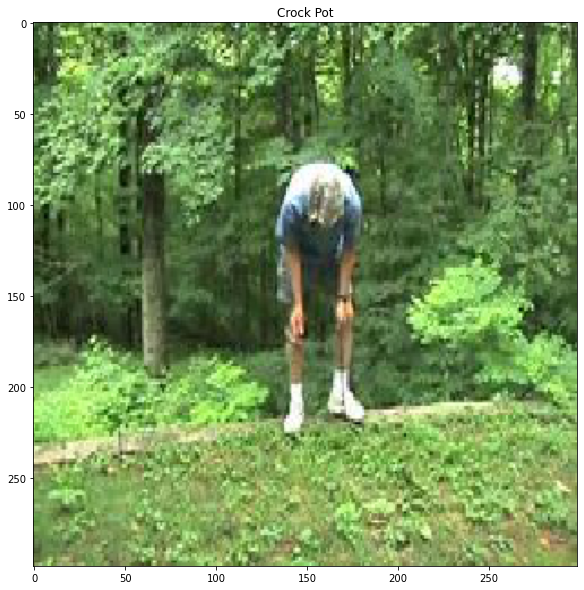

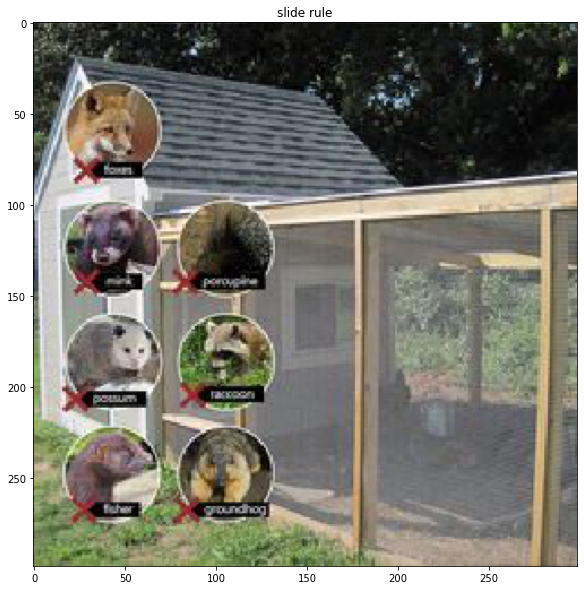

In [46]:
for i, img_url in enumerate(sample_data["urls"]):
    print(img_url)

    img_path = tf.keras.utils.get_file(f"snake_fence_{i}", origin=img_url)
    img = tf.keras.preprocessing.image.load_img(
        img_path, target_size=(299, 299)
    )
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0)


    img_processed = preprocess_input(img_array)



    prediction = model.predict(img_processed)
    score = tf.nn.softmax(prediction[0])
    label = imagenet_labels[np.argmax(score)]
    print(
        "This image most likely belongs to {} with a {:.2f} percent confidence."
        .format(label, 100 * np.max(score))
    )
    plt.figure(figsize=(10, 10))
    plt.imshow(img_array[0].numpy().astype("uint8"))
    plt.title(label)

In [49]:
for l in sorted(imagenet_labels):
    print(l)

Afghan hound
African chameleon
African crocodile
African elephant
African grey
African hunting dog
Airedale
American Staffordshire terrier
American alligator
American black bear
American chameleon
American coot
American egret
American lobster
Angora
Appenzeller
Arabian camel
Arctic fox
Australian terrier
Band Aid
Bedlington terrier
Bernese mountain dog
Blenheim spaniel
Border collie
Border terrier
Boston bull
Bouvier des Flandres
Brabancon griffon
Brittany spaniel
CD player
Cardigan
Chesapeake Bay retriever
Chihuahua
Christmas stocking
Crock Pot
Dandie Dinmont
Doberman
Dungeness crab
Dutch oven
Egyptian cat
English foxhound
English setter
English springer
EntleBucher
Eskimo dog
European fire salamander
European gallinule
French bulldog
French horn
French loaf
German shepherd
German short-haired pointer
Gila monster
Gordon setter
Granny Smith
Great Dane
Great Pyrenees
Greater Swiss Mountain dog
Ibizan hound
Indian cobra
Indian elephant
Irish setter
Irish terrier
Irish water spaniel
Iris

so snake fence isn't even in the classes, thanks @yrevar
https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a

let's try something that is in the labels and also examine top 5 or 10 predictions to validate if image is relevant

This image most likely belongs to wing with a 0.21 percent confidence.


Text(0.5, 1.0, 'wing')

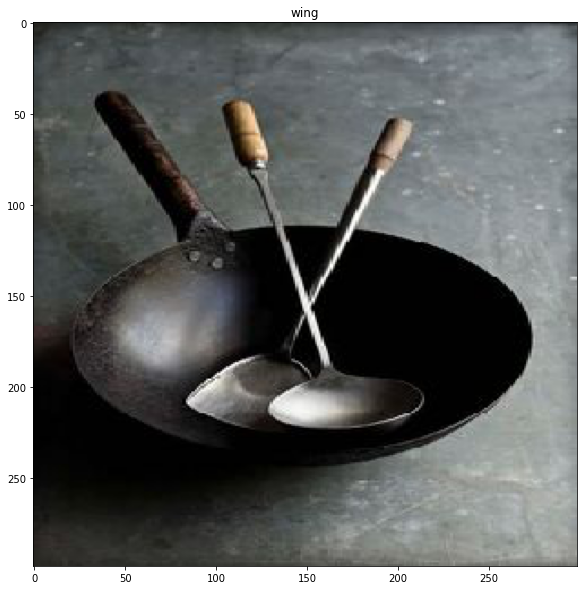

In [53]:
wok_url = "https://i.pinimg.com/236x/84/e6/49/84e649b9618bb38c3394223b772cd846.jpg"

img_path = tf.keras.utils.get_file(f"wok_image_1", origin=wok_url)
img = tf.keras.preprocessing.image.load_img(
    img_path, target_size=(299, 299)
)
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0)
img_processed = preprocess_input(img_array)

prediction = model.predict(img_processed)
score = tf.nn.softmax(prediction[0])
label = imagenet_labels[np.argmax(score)]
print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(label, 100 * np.max(score))
)
plt.figure(figsize=(10, 10))
plt.imshow(img_array[0].numpy().astype("uint8"))
plt.title(label)


In [71]:
label_indexes = [i for i in range(len(imagenet_labels[1:]))]
label_indexes

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 184,


In [60]:
list(imagenet_labels).index('wok')

910

In [63]:
imagenet_labels

array(['background', 'tench', 'goldfish', ..., 'bolete', 'ear',
       'toilet tissue'], dtype='<U30')

In [80]:
tf.math.in_top_k(
    [909], prediction, 1, name=None
)

<tf.Tensor: shape=(1,), dtype=bool, numpy=array([ True])>

In [69]:
prediction.shape

(1, 1000)

In [70]:
imagenet_labels.shape

(1001,)

this highlights that the imagenet_labels have an extra class, likely bg, that the model isn't including


This image most likely belongs to wok with a 0.21 percent confidence.


Text(0.5, 1.0, 'wok')

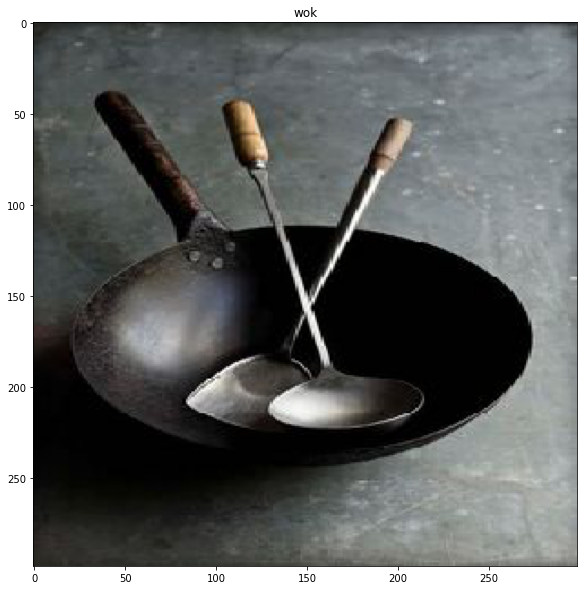

In [81]:
actual_labels = imagenet_labels[1:]

img_path = tf.keras.utils.get_file(f"wok_image_1", origin=wok_url)
img = tf.keras.preprocessing.image.load_img(
    img_path, target_size=(299, 299)
)
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0)
img_processed = preprocess_input(img_array)

prediction = model.predict(img_processed)
score = tf.nn.softmax(prediction[0])
label = actual_labels[np.argmax(score)]
print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(label, 100 * np.max(score))
)
plt.figure(figsize=(10, 10))
plt.imshow(img_array[0].numpy().astype("uint8"))
plt.title(label)

Finally! Results. Let's check our initial Lady's slipper images again:

16384/14526 [=================================] - 0s 0us/step
This image most likely belongs to yellow lady's slipper with a 0.26 percent confidence.


Text(0.5, 1.0, "yellow lady's slipper")

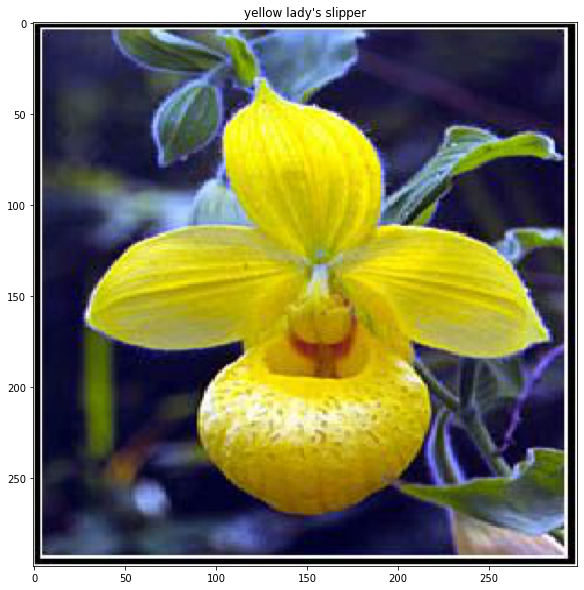

In [82]:
eg_url = "https://i.pinimg.com/236x/45/34/ce/4534ceebdc3ff1b0c612edf73702cf73--yellow-orchid-orchid-flowers.jpg"

img_path = tf.keras.utils.get_file(f"ladys_slipper_1", origin=eg_url)
img = tf.keras.preprocessing.image.load_img(
    img_path, target_size=(299, 299)
)
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0)
img_processed = preprocess_input(img_array)

prediction = model.predict(img_processed)
score = tf.nn.softmax(prediction[0])
label = actual_labels[np.argmax(score)]
print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(label, 100 * np.max(score))
)
plt.figure(figsize=(10, 10))
plt.imshow(img_array[0].numpy().astype("uint8"))
plt.title(label)


let's also check the snake fence class already scraped to see if that has a different label as the labels seem to be
shorter versions of @yrevar's gist

This image most likely belongs to worm fence with a 0.25 percent confidence.


Text(0.5, 1.0, 'worm fence')

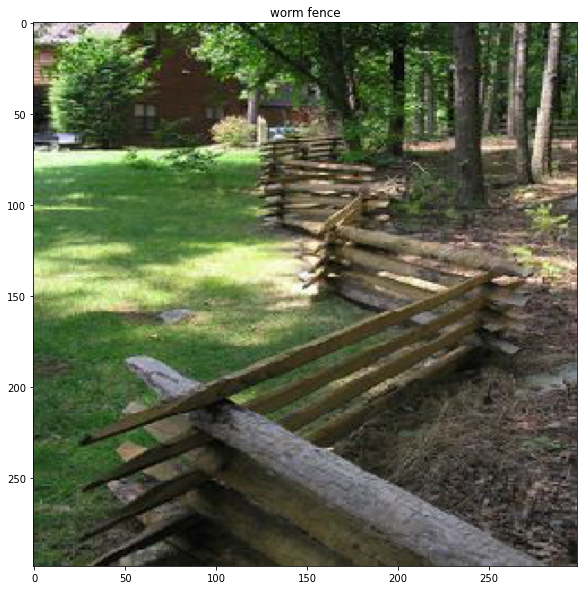

In [6]:
# restarting server so reimporting
import json
import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import InceptionResNetV2
from tensorflow.keras.applications.inception_resnet_v2 import preprocess_input
import matplotlib.pyplot as plt


model = InceptionResNetV2(weights='imagenet', input_shape=(299, 299, 3))

labels_path = tf.keras.utils.get_file('ImageNetLabels.txt','https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt')
imagenet_labels = np.array(open(labels_path).read().splitlines())
actual_labels = imagenet_labels[1:]
with open("sample_urls.json") as f:
    sample_data = json.load(f)

img_path = tf.keras.utils.get_file(f"sample_sample", origin=sample_data["urls"][1])
img = tf.keras.preprocessing.image.load_img(
    img_path, target_size=(299, 299)
)
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0)
img_processed = preprocess_input(img_array)

prediction = model.predict(img_processed)
score = tf.nn.softmax(prediction[0])
label = actual_labels[np.argmax(score)]
print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(label, 100 * np.max(score))
)
plt.figure(figsize=(10, 10))
plt.imshow(img_array[0].numpy().astype("uint8"))
plt.title(label)

okay so @yrevar's gist definitely is not wrong, just has longer terms. could potentially be used to enrich
results or add synonyms in indexing system

Exploring ranking using classification results - if label matched as top prediction can consider the pinterest image as
highly relevant, but the classifier could mis-classify. Could check to see if it's in the top X results and order images
by this ranking

In [9]:
list(actual_labels).index("worm fence")

912

In [11]:
top_result = tf.math.in_top_k(
    [list(actual_labels).index("worm fence")], prediction, 1, name=None
)
top_result

<tf.Tensor: shape=(1,), dtype=bool, numpy=array([ True])>

In [14]:
if top_result[0]:
    print(True)

True


In [15]:
top_result = tf.math.in_top_k(
    [0], prediction, 1, name=None
)
top_result


<tf.Tensor: shape=(1,), dtype=bool, numpy=array([False])>

In [16]:
if top_result[0]:
    print(True)
else:
    print(False)

False


also just realised a potential issue: one of the labels in the imagenet labels may present an issue ("cock")

a quick test shows that pinterest actually prevents people tagging images with this label (thankfully), so will need to map this to "cockerel".

Let's test to make sure it works

24576/19132 [======================================] - 0s 0us/step
This image most likely belongs to cock with a 0.25 percent confidence.


Text(0.5, 1.0, 'cock')

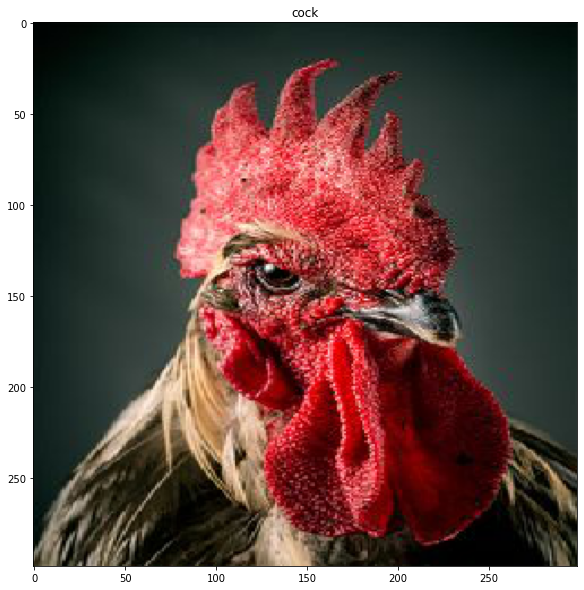

In [17]:
img_path = tf.keras.utils.get_file(f"cock_test", origin="https://i.pinimg.com/236x/53/61/0a/53610a2f420218fd83bbf31ebb908ad5--have-zoom.jpg")
img = tf.keras.preprocessing.image.load_img(
    img_path, target_size=(299, 299)
)
img_array = tf.keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0)
img_processed = preprocess_input(img_array)

prediction = model.predict(img_processed)
score = tf.nn.softmax(prediction[0])
label = actual_labels[np.argmax(score)]
print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(label, 100 * np.max(score))
)
plt.figure(figsize=(10, 10))
plt.imshow(img_array[0].numpy().astype("uint8"))
plt.title(label)

okay cool, so that confirms that. what a menacing looking bird! at least it is a bird we're classifying...

Let's double check the labels:

In [18]:
for l in actual_labels:
    print(l)

tench
goldfish
great white shark
tiger shark
hammerhead
electric ray
stingray
cock
hen
ostrich
brambling
goldfinch
house finch
junco
indigo bunting
robin
bulbul
jay
magpie
chickadee
water ouzel
kite
bald eagle
vulture
great grey owl
European fire salamander
common newt
eft
spotted salamander
axolotl
bullfrog
tree frog
tailed frog
loggerhead
leatherback turtle
mud turtle
terrapin
box turtle
banded gecko
common iguana
American chameleon
whiptail
agama
frilled lizard
alligator lizard
Gila monster
green lizard
African chameleon
Komodo dragon
African crocodile
American alligator
triceratops
thunder snake
ringneck snake
hognose snake
green snake
king snake
garter snake
water snake
vine snake
night snake
boa constrictor
rock python
Indian cobra
green mamba
sea snake
horned viper
diamondback
sidewinder
trilobite
harvestman
scorpion
black and gold garden spider
barn spider
garden spider
black widow
tarantula
wolf spider
tick
centipede
black grouse
ptarmigan
ruffed grouse
prairie chicken
peacock

"drake" is a label which won't work with the popular pinterest, let's see what the equivalent in yrevar's gist is


In [22]:
drake_index = list(actual_labels).index("drake")
drake_index

97

In [20]:
import urllib.request

url = "https://gist.githubusercontent.com/yrevar/942d3a0ac09ec9e5eb3a/raw/238f720ff059c1f82f368259d1ca4ffa5dd8f9f5/imagenet1000_clsidx_to_labels.txt"
file = urllib.request.urlopen(url)

for line in file:
	decoded_line = line.decode("utf-8")
	print(decoded_line)

{0: 'tench, Tinca tinca',

 1: 'goldfish, Carassius auratus',

 2: 'great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias',

 3: 'tiger shark, Galeocerdo cuvieri',

 4: 'hammerhead, hammerhead shark',

 5: 'electric ray, crampfish, numbfish, torpedo',

 6: 'stingray',

 7: 'cock',

 8: 'hen',

 9: 'ostrich, Struthio camelus',

 10: 'brambling, Fringilla montifringilla',

 11: 'goldfinch, Carduelis carduelis',

 12: 'house finch, linnet, Carpodacus mexicanus',

 13: 'junco, snowbird',

 14: 'indigo bunting, indigo finch, indigo bird, Passerina cyanea',

 15: 'robin, American robin, Turdus migratorius',

 16: 'bulbul',

 17: 'jay',

 18: 'magpie',

 19: 'chickadee',

 20: 'water ouzel, dipper',

 21: 'kite',

 22: 'bald eagle, American eagle, Haliaeetus leucocephalus',

 23: 'vulture',

 24: 'great grey owl, great gray owl, Strix nebulosa',

 25: 'European fire salamander, Salamandra salamandra',

 26: 'common newt, Triturus vulgaris',

 27: 'eft',

 28: 'sp

In [21]:
file[0]


TypeError: 'HTTPResponse' object is not subscriptable